In [1]:
import os, sys
import numpy as np
import ants
import argparse
import shutil
import logging
import subprocess
import tqdm
import matplotlib.pyplot as plt 
import torchio as tio
from glob2 import glob

Для модели 1 reg и 3a atlas посчитать метрики и сравнить

In [9]:
# os.mkdir('/anvar/public_datasets/preproc_study/gbm/inference/gbm_3a_atlas_spacing/')

In [144]:
def plot_qc(image, mask, patient_id = 'test'):
    fig, axs = plt.subplots(3,3,figsize=(12,12))
    idx = np.argsort(mask.sum(axis=(0,1)))[-3:]
    for i in range(3):
        axs[i, 0].imshow(image[..., idx[i]], cmap='gray')
        axs[i, 1].imshow(mask[..., idx[i]], cmap='gray')
        axs[i, 2].imshow(image[..., idx[i]]+200*mask[..., idx[i]], cmap='gray')
    axs[0,0].set_title(patient_id)
    plt.tight_layout()
#     plt.savefig(f'/home/kate/projects/qc_preprocessing/{path}_gbm/{patient_id}.png', dpi=300)
    plt.plot()
#     plt.close(fig)

In [89]:
infer_dir = '/anvar/public_datasets/preproc_study/gbm/inference/gbm_3a_atlas/predictions_best_epoch=71-dice_mean=69_92_task=20_fold=0_tta'
old_orig = '/anvar/public_datasets/preproc_study/gbm/3a_atlas/'
new_orig = '/anvar/public_datasets/preproc_study/gbm/1_reg/'
save_dir = '/anvar/public_datasets/preproc_study/gbm/inference/gbm_3a_atlas_spacing/'

In [156]:
new_array = new_array.transpose(0,3,2,1)

In [157]:
new_orig_ct1.numpy().shape, new_array.shape

((256, 256, 23), (3, 256, 256, 23))

In [158]:
new_array[0].shape

(256, 256, 23)

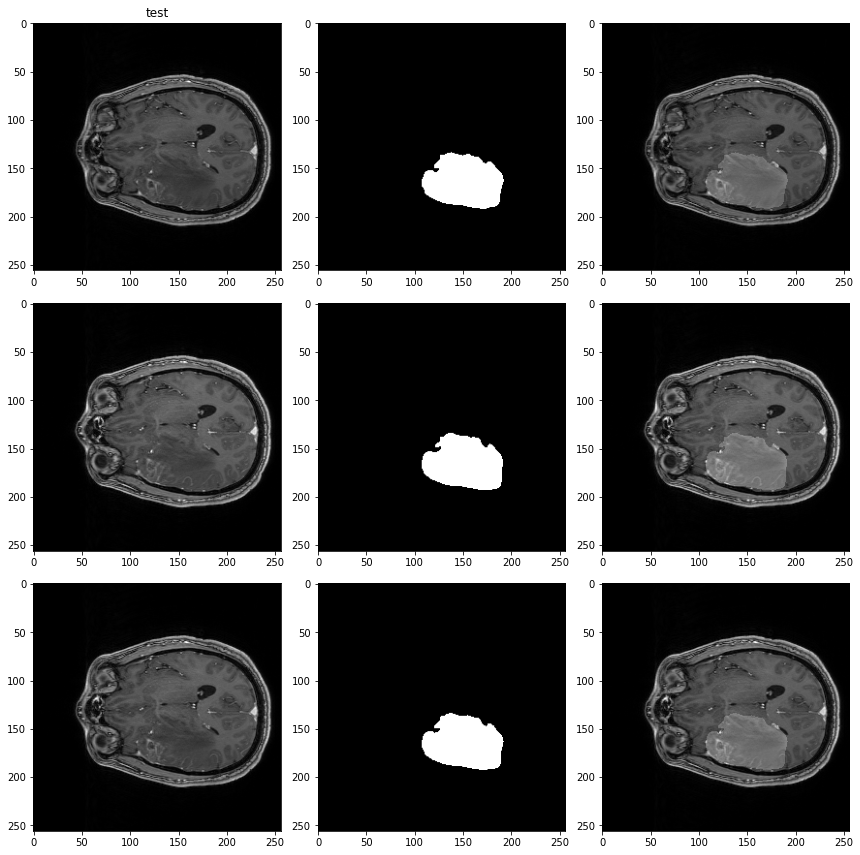

In [179]:
plot_qc(new_orig_ct1.numpy(), new_array[0].round(0).astype(int))

In [166]:
new_array[0].round(0).dtype

dtype('float16')

In [175]:
new_mask_ct1 = ants.image_read(new_orig + i + '/CT1_SEG.nii.gz')

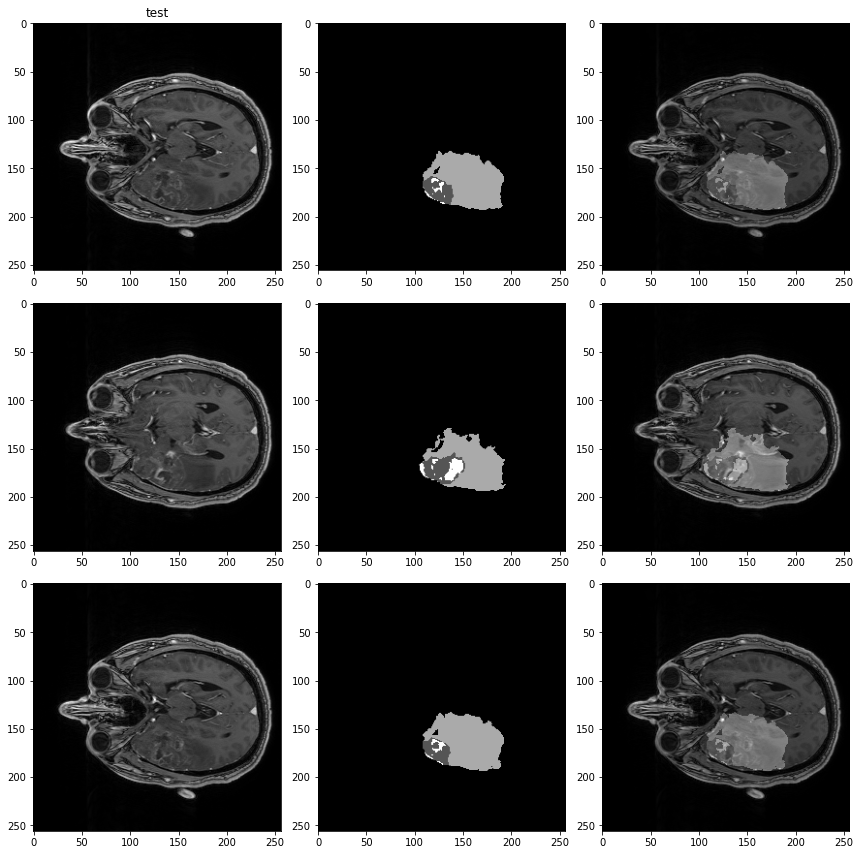

In [176]:
plot_qc(new_orig_ct1.numpy(), new_mask_ct1.numpy())

In [ ]:
plot_qc(new_orig_ct1.numpy(), new_mask_ct1.numpy())

(256, 256, 23)
(256, 256, 23)
(512, 512, 23)
(512, 512, 124)
(256, 256, 192)
(256, 256, 79)
(256, 256, 124)
(256, 256, 23)
(192, 256, 28)
(256, 256, 22)
(512, 512, 67)
(256, 37, 256)
(256, 256, 54)
(256, 256, 124)
(256, 256, 68)
(256, 256, 24)
(256, 256, 68)
(16, 256, 256)
(256, 256, 23)
(512, 512, 25)
(512, 512, 124)
(240, 320, 27)
(256, 256, 51)
(256, 256, 23)
(256, 256, 102)
(256, 256, 23)
(256, 256, 72)
(320, 384, 24)
(512, 512, 75)
(256, 256, 20)
(256, 256, 23)
(256, 256, 68)
(256, 256, 56)
(512, 512, 71)
(240, 320, 31)
(192, 256, 20)
(192, 176, 256)
(256, 256, 24)
(256, 256, 34)
(384, 512, 23)
(256, 256, 20)
(256, 256, 23)
(512, 512, 120)
(256, 256, 124)
(512, 448, 72)
(256, 256, 124)
(256, 256, 124)
(512, 512, 25)
(256, 256, 192)
(256, 256, 23)
(512, 512, 72)
(256, 256, 108)
(512, 45, 512)
(256, 256, 71)
(512, 512, 71)
(512, 512, 124)
(256, 256, 50)
(512, 512, 23)
(320, 320, 22)
(256, 256, 60)
(256, 256, 124)
(320, 320, 24)
(256, 256, 124)
(512, 512, 30)
(208, 256, 34)
(256, 256

FileNotFoundError: [Errno 2] No such file or directory: '/anvar/public_datasets/preproc_study/gbm/inference/gbm_3a_atlas/predictions_best_epoch=71-dice_mean=69_92_task=20_fold=0_tta/logging.txt.npy.npz'

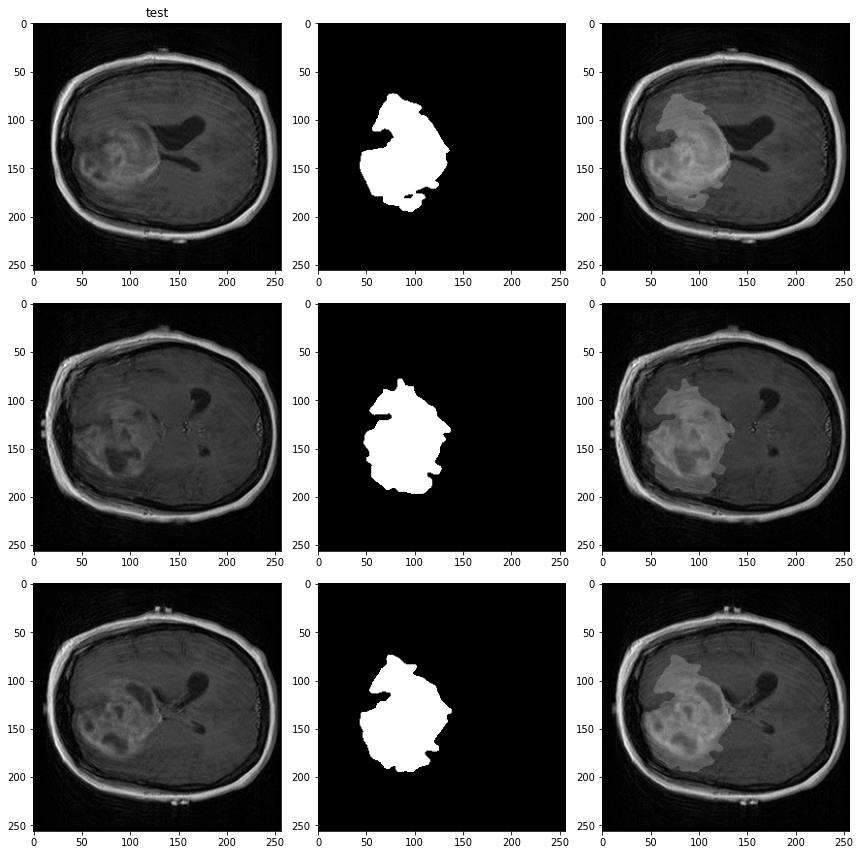

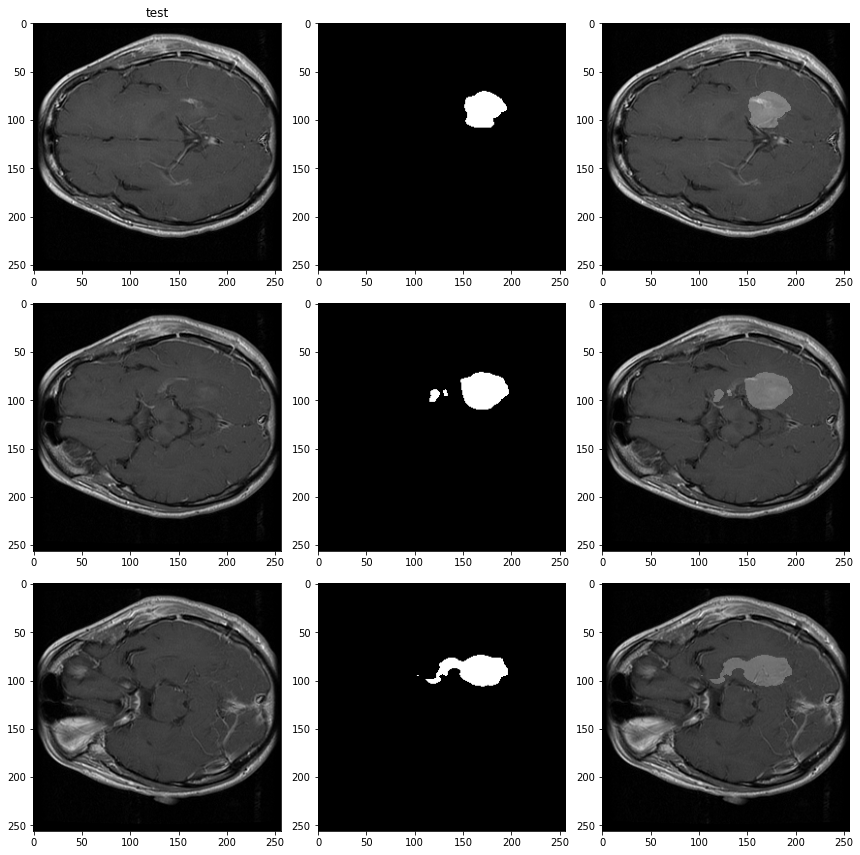

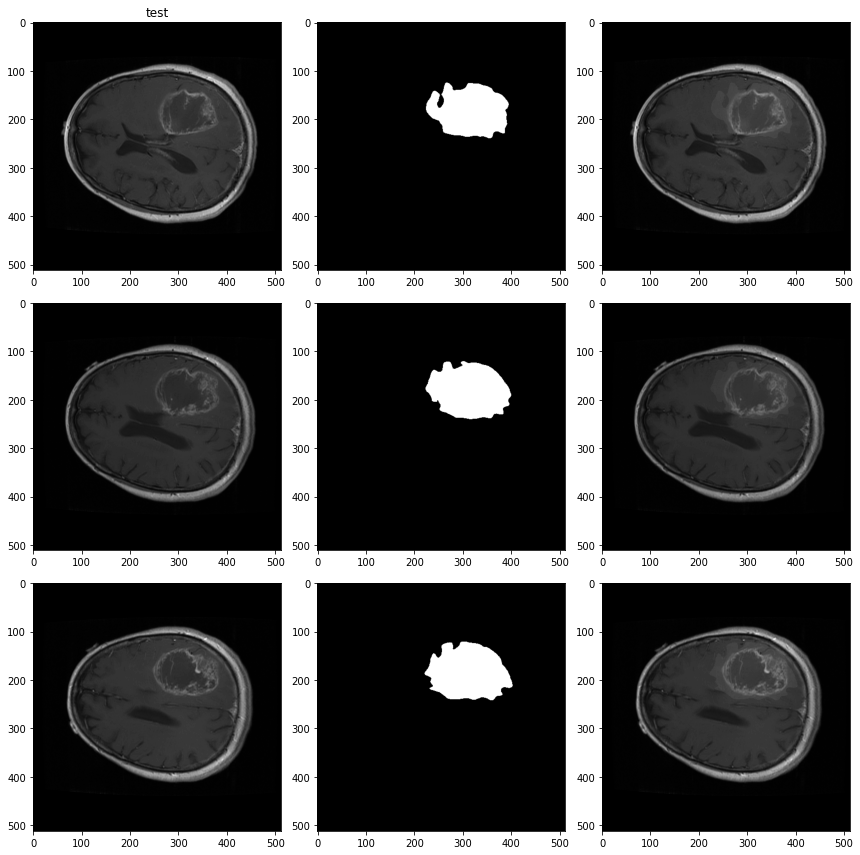

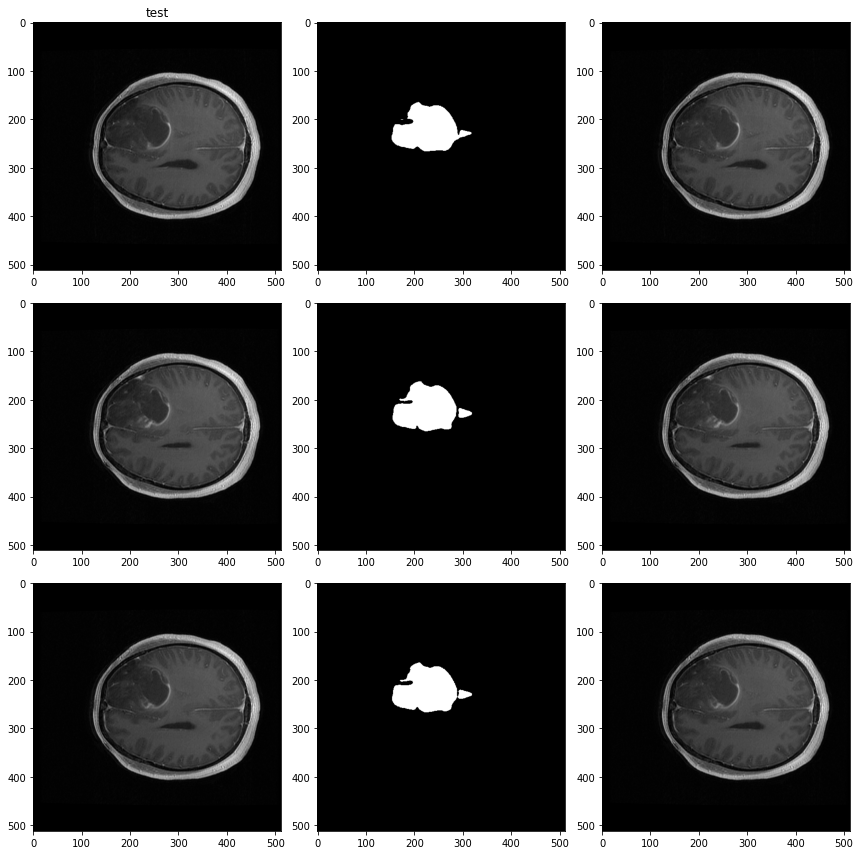

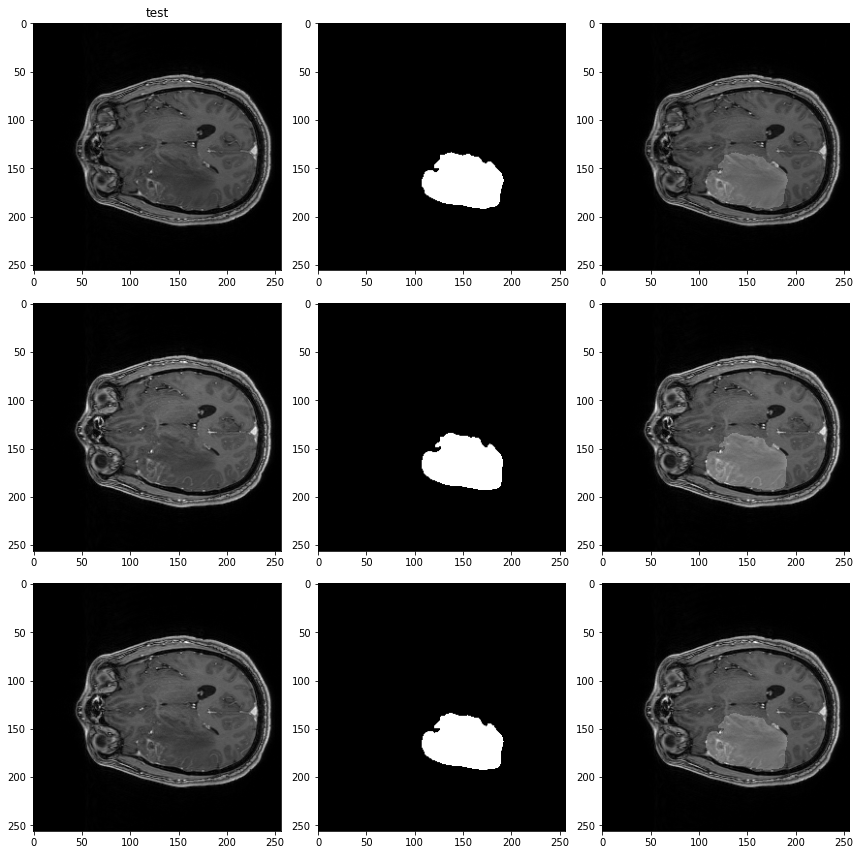

...

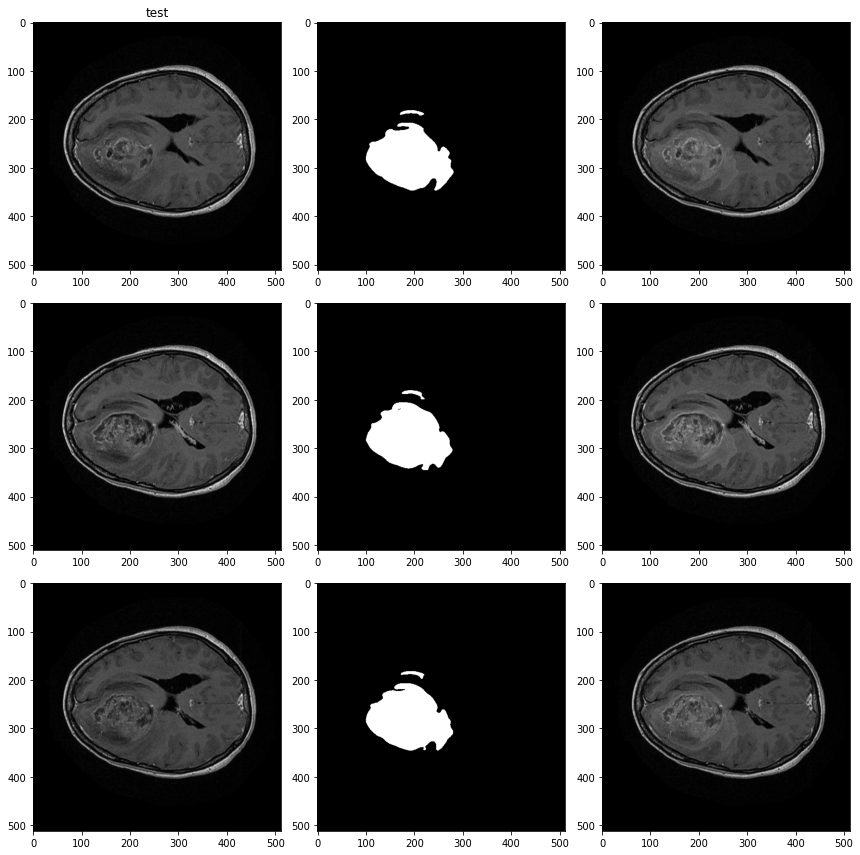

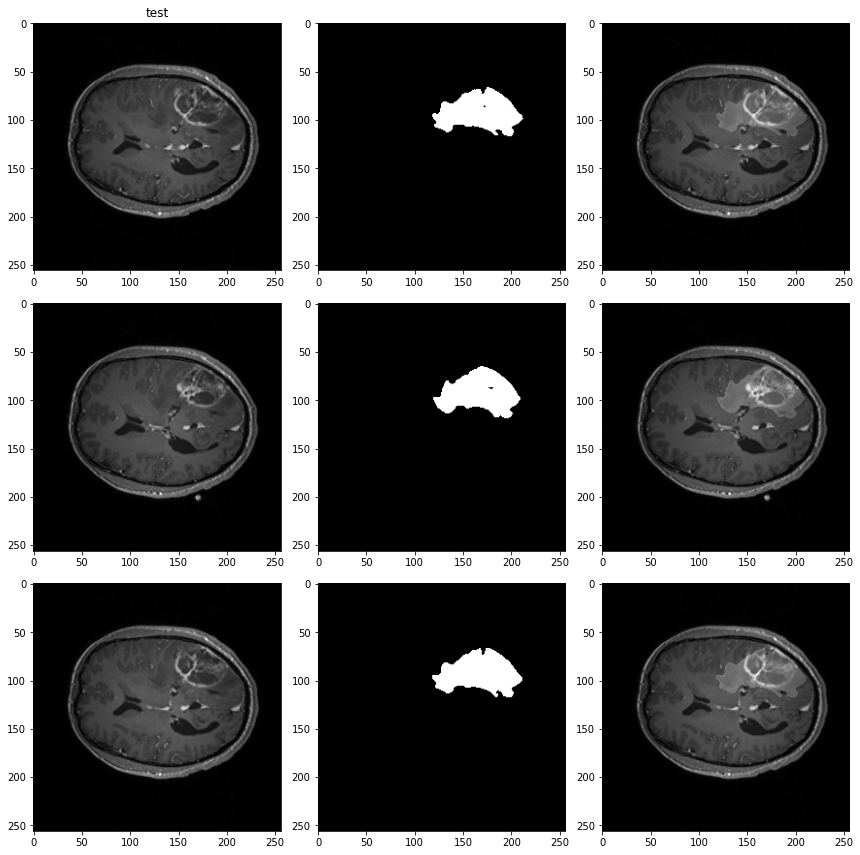

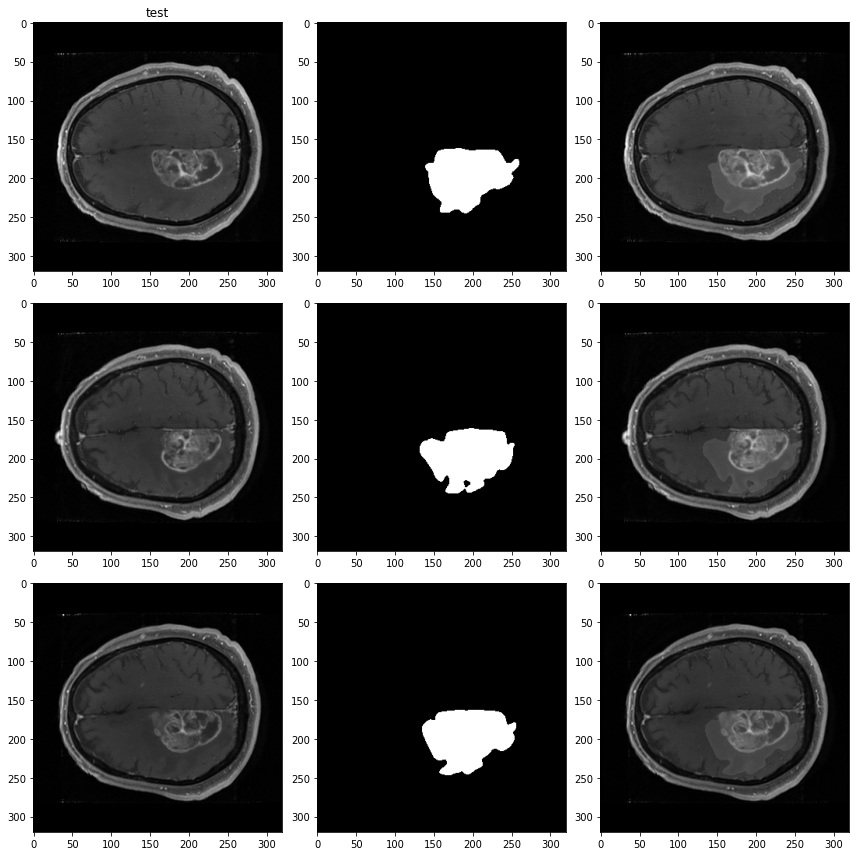

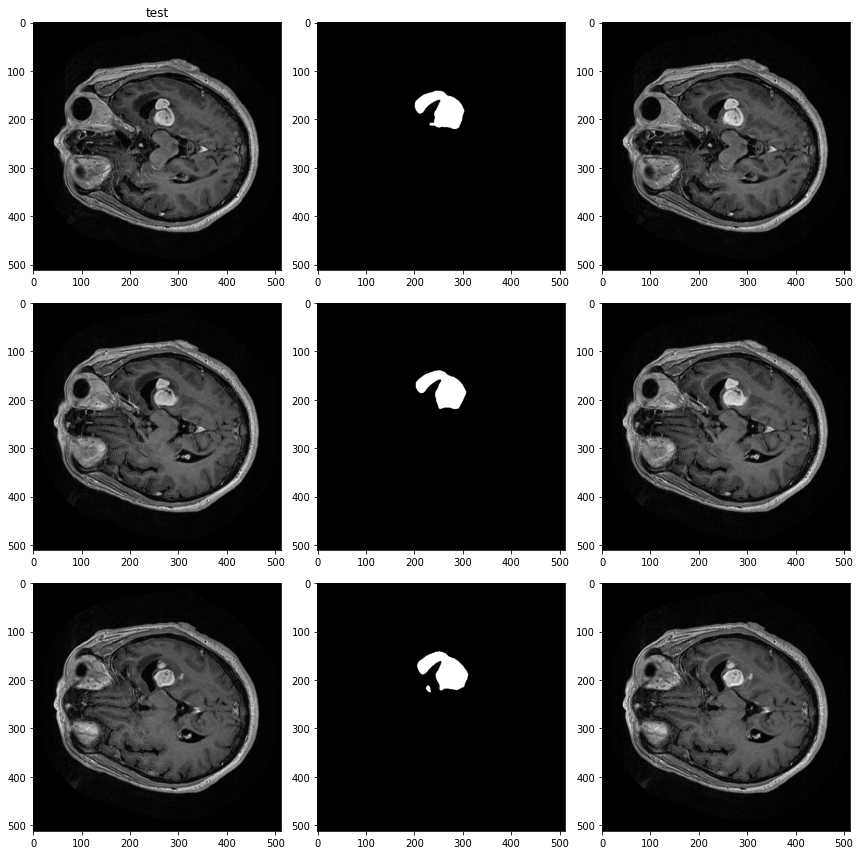

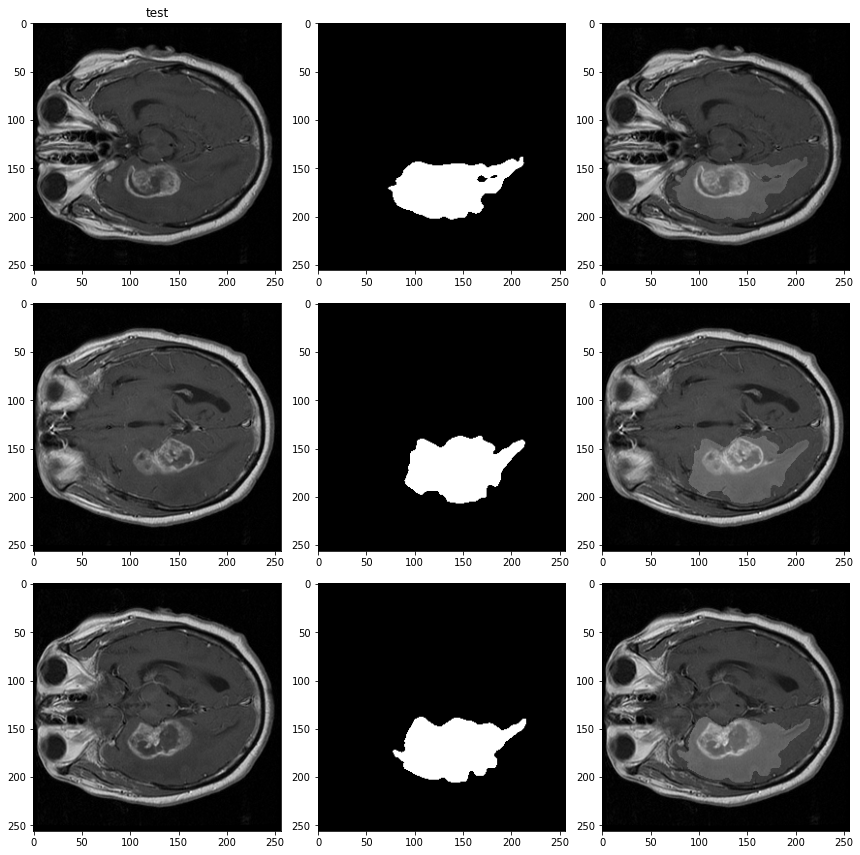

In [182]:
for i in os.listdir(old_orig):
    with np.load(infer_dir + '/' + i + '.npy.npz') as data:
            data = data['arr_0'].transpose(0,3,2,1).astype('float32')

            old_orig_ct1 = ants.image_read(old_orig + i + '/CT1.nii.gz')
            new_orig_ct1 = ants.image_read(new_orig + i + '/CT1.nii.gz')
            
            
            old_like_ch_0 = old_orig_ct1.new_image_like(data[0])
            old_like_ch_1 = old_orig_ct1.new_image_like(data[1])
            old_like_ch_2 = old_orig_ct1.new_image_like(data[2])
            
            res = ants.registration(fixed=new_orig_ct1, moving=old_orig_ct1,
                            type_of_transform='Rigid')
    
            new_img_0 = ants.apply_transforms(new_orig_ct1, old_like_ch_0,
                                    transformlist = res['fwdtransforms'][0])
            new_img_1 = ants.apply_transforms(new_orig_ct1, old_like_ch_1,
                                    transformlist = res['fwdtransforms'][0])
            new_img_2 = ants.apply_transforms(new_orig_ct1, old_like_ch_2,
                                    transformlist = res['fwdtransforms'][0])
            new_img_shape =  new_img_2.numpy().shape
            
            new_array = np.zeros(tuple([3] + list(new_img_shape)), dtype='float16')
            new_array[0] = new_img_0.numpy()
            new_array[1] = new_img_1.numpy()
            new_array[2] = new_img_2.numpy()
            
            print(new_array[0].shape)
            plot_qc(new_orig_ct1.numpy(), new_array[0].round(0).astype(int))
            np.savez(save_dir + '/' + i + '.npz',new_array.transpose(0,3,2,1).astype('float16'))

In [ ]:
%run ./utils/metrics.py 

 99%|█████████▉| 98/99 [02:51<00:01,  1.31s/it]

In [133]:
i

'TCGA-12-1094'

In [134]:
pd.read_csv('/anvar/public_datasets/preproc_study/gbm/inference/1_reg_labels.csv')

,Unnamed: 0,Ids,Dice_1,Dice_2,Dice_3,Hausdorff95_1,Hausdorff95_2,Hausdorff95_3,Sensitivity_1,Sensitivity_2,Sensitivity_3,Specificity_1,Specificity_2,Specificity_3,Surface_dice_1,Surface_dice_2,Surface_dice_3,Precision_1,Precision_2,Precision_3
0,0,TCGA-02-0086,0.600911,0.581038,0.361135,15.583727,15.133327,14.971131,0.586022,0.669047,0.270178,0.98809,0.989704,0.99692,0.208792,0.236679,0.337112,0.616577,0.513492,0.544415


In [93]:
os.listdir('/anvar/public_datasets/preproc_study/gbm/inferece/gbm_3a_atlas_spacing)

SyntaxError: invalid syntax (376833480.py, line 1)

In [ ]:
dices = []
s_dices = []
for image in os.listdir(shared):
    print(image)
    for mod in ['T2_mask.nii.gz', 'FLAIR_mask.nii.gz', 'T1_mask.nii.gz',  'CT1_mask.nii.gz']:
            
            img_new = ants.image_read(shared + '/' + image +'/' + 'CT1_mask.nii.gz')
            img_old = ants.image_read(individual + '/' + image +'/' + mod).numpy()
            spacing = img_new.spacing
            df = calculate_metrics_brats(img_new.numpy(), img_old, image, spacing)
            dices.append(df['Dice_0'])
            s_dices.append(df['Surface_dice_0'])
#             try:
#                 if np.allclose(img_new.numpy(),img_old.numpy()):
#                     print('For ', image, mod,  'images are the same')
#             except Exception as e:
#                 pass
    print( 'Dice min and mean', np.array(dices).min(),  np.array(dices).mean(), 'Surface Dice min and mean', np.array(s_dices).min(),  np.array(s_dices).mean())